# **Modelo Supervisado para Clasificar puntos usando redes neurales en Keras** 

En este proyecto se pretende  construir y analizar el comportamiento de un modelo que nos permita clasificar un conjunto de puntos de un dataset generado a partir de una simulación. Para ello usaremos redes neurales  a modo de ver su gran potencial, a traves de la libreria Keras. 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from sklearn.datasets import make_circles, make_moons
from sklearn.model_selection import train_test_split
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import np_utils
%tensorflow_version 1.x 
%matplotlib inline

Using TensorFlow backend.


##EL DATASET
A continuación vamos a ver la estructura del dataset que vamos a emplear.

**NOTA**: Valga la pena mencionar que usar otras herramientas más comunes de machine learning pueden ser complejo dado la estructura del dataset.


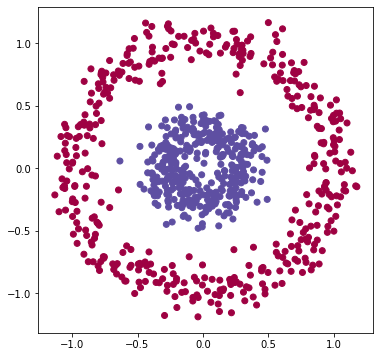

In [2]:
#For training test
X, y = make_circles(1000, factor = 0.3, noise = .1)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)
plt.figure(figsize = (6, 6))
plt.scatter(X_train[:, 0], X_train[:, 1], c = y_train.ravel(), cmap = plt.cm.Spectral)

Utilidades


In [0]:
X_START = np.min(X[:,0])
X_END = np.max(X[:,0])
Y_START = np.min(X[:,1])
Y_END = np.max(X[:,1])
grid = np.mgrid[X_START:X_END:100j,X_START:Y_END:100j]
grid_2d = grid.reshape(2, -1).T
xx, yy = grid
N_EPOCHS = 40

def makeIndexOfLength(index, length):
    indexStr = str(index)
    return ('0' * (length - len(indexStr)) + indexStr)

def save_model_prediction_graph(epoch, logs):
    #clear_output()
    prediction_probs = model.predict_proba(grid_2d, batch_size=32, verbose=0)
    acc_history.append(logs['acc'])
    loss_history.append(logs['loss'])
    fig, axs = plt.subplots(1, 2, figsize =(12, 6))

    axs[0].set_title('epoch: ' + makeIndexOfLength(epoch, 3), fontsize=20)
    axs[0].contourf(xx, yy, prediction_probs.reshape(100, 100), alpha = 0.7, cmap=cm.Spectral)
    axs[0].scatter(X_train[:, 0], X_train[:, 1], c=y_train.ravel(), s=50, cmap=plt.cm.Spectral, edgecolors='black')
    
    axs[1].plot(acc_history)
    axs[1].plot(loss_history)
    axs[1].set_title('Model accuracy and loss - epoch: ' + makeIndexOfLength(epoch, 3), fontsize=20)
    axs[1].set_ylabel('accuracy')
    axs[1].set_xlabel('epoch')
    axs[1].set_xlim([0,N_EPOCHS])
    axs[1].legend(['accuracy', 'loss'], loc='upper left')
    fig.tight_layout()
    plt.show(fig)

# Construcción del modelo con Keras

Métricas para evaluar el modelo:

$$\text{Accuracy} = \frac{\text{# de predicciones correctas}}{\text{# total de predicciones}}$$

$$\text{Cross Entropy} = \sum_{(x,y)} -y \log{y'} - (1-y)\log{(1-y')}$$

donde $y$ es la etiqueta de cada dato y $y'$ es la etiqueta predicha por el modelo.






Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where










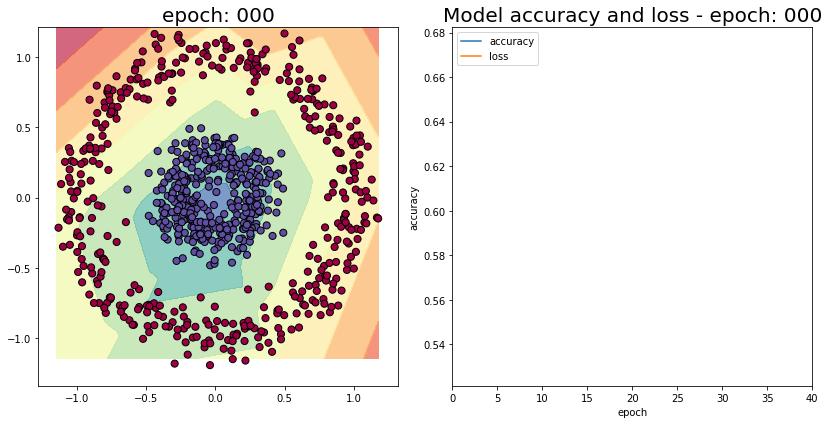

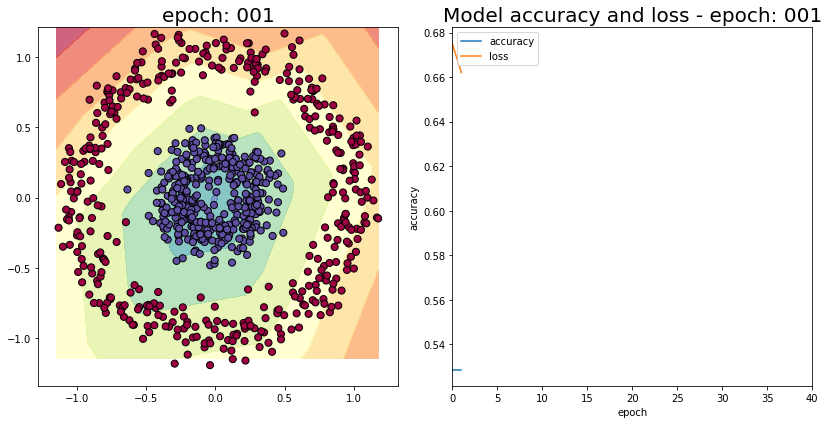

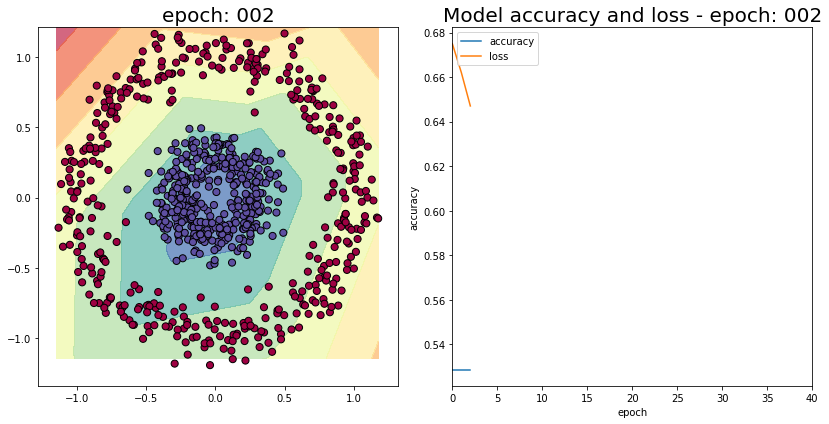

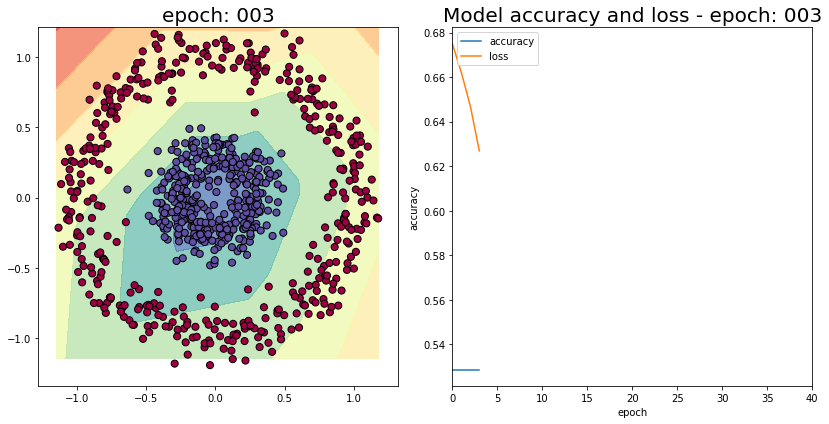

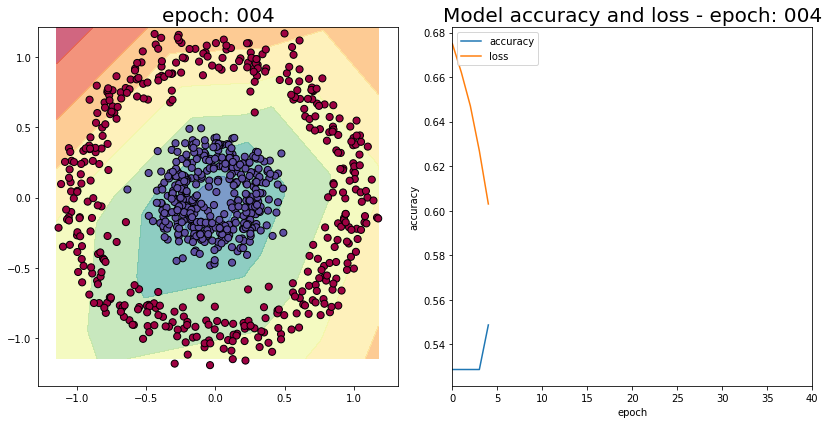

...

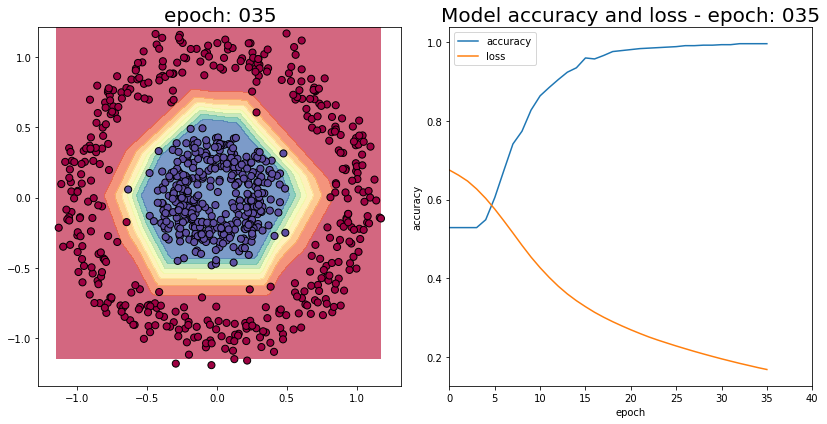

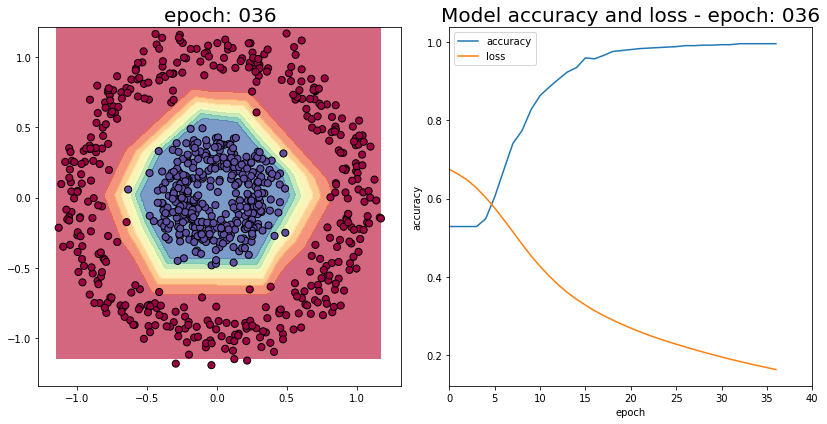

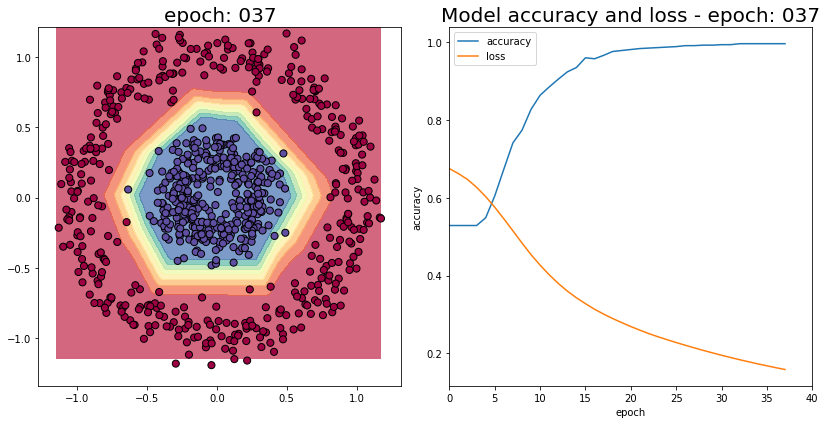

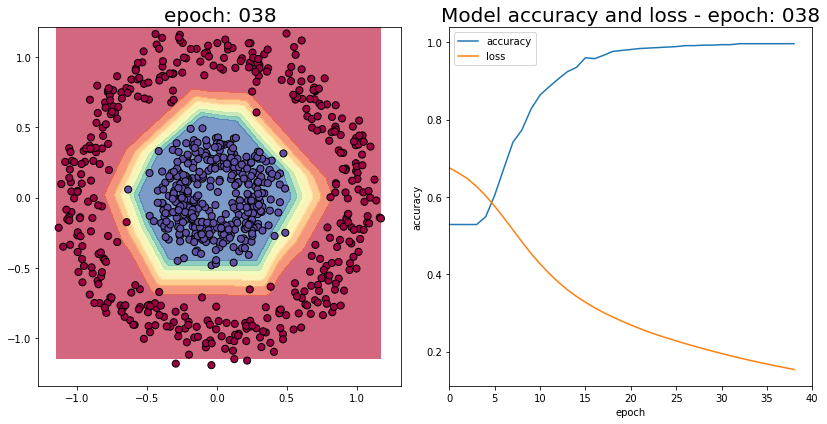

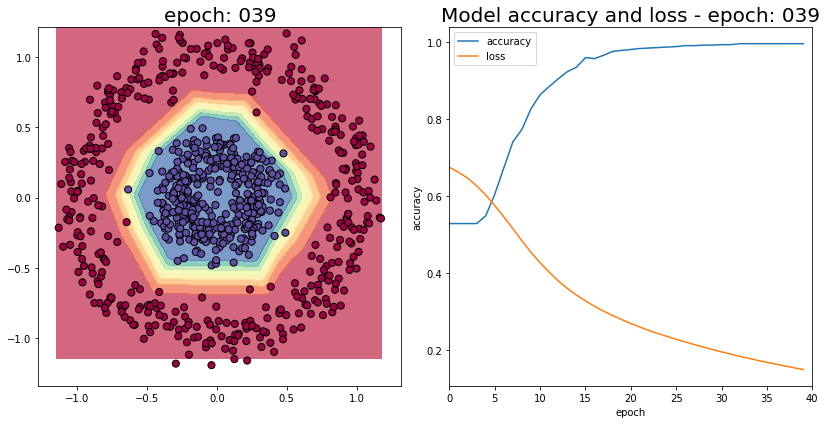

Test loss: 0.19689421594142914
Test accuracy: 0.985


In [4]:
acc_history = []
loss_history = []
# el modelo que vamos a definir esta compuesto por capas de tipo "Fully-Connected(FC)" que tienen la siguiente estructura
# X->RELU->RELU->RELU->RELU->Sigmoid->Y
model = Sequential()
model.add(Dense(4, input_dim=2, activation='relu'))
model.add(Dense(6, activation = 'relu'))
model.add(Dense(6, activation = 'relu'))
model.add(Dense(4, activation = 'relu'))
model.add(Dense(1, activation = 'sigmoid'))
testmodelcb = keras.callbacks.LambdaCallback(on_epoch_end=save_model_prediction_graph)
model.compile(loss = 'binary_crossentropy', optimizer = 'adamax', metrics = ['accuracy'])
history = model.fit(X_train, y_train, epochs=N_EPOCHS, verbose=0, callbacks=[testmodelcb])
score = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Como puede verse el modelo construido clasifica los datos con un accuracy del 98.5 % !!

## SEGUNDO DATASET

Probemos ahora con otro dataset construido de manera analoga a como se obtuvo el usado en el modelo anterior.

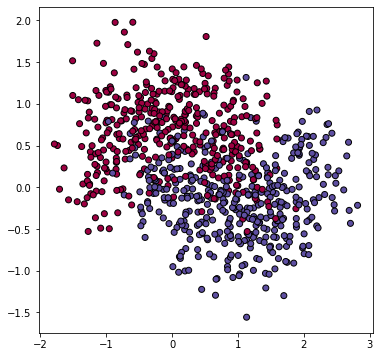

In [5]:
#For overfitting test
X, y = make_moons(1000, noise=0.4, random_state=100)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)
plt.figure(figsize = (6, 6))
plt.scatter(X_train[:, 0], X_train[:, 1], c = y_train.ravel(), cmap = plt.cm.Spectral, edgecolors = 'black')

##MODELO USANDO REGULARIZACIÓN
En este caso vamos a usar una red neural con la misma estructura, pero analizaremos dos casos: En el primero usaremos un esquema similar al usado en el anterior dataset, pero en el segundo se aplica regularización en algunas de las capas.

###MODELO ESTANDAR
Sin usar regularización

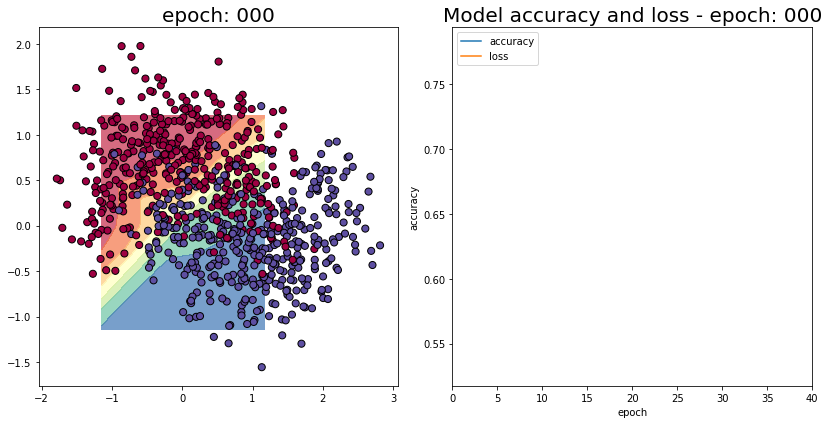

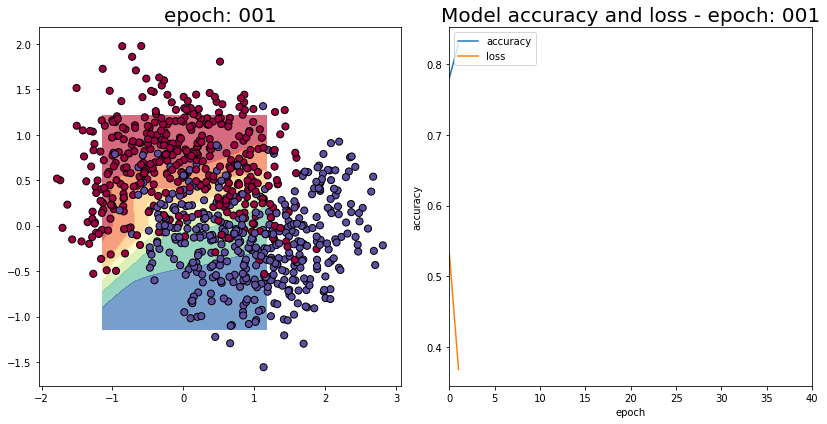

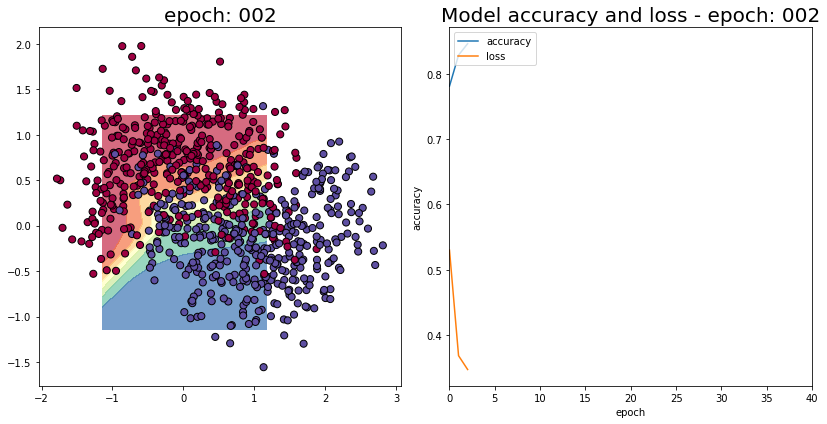

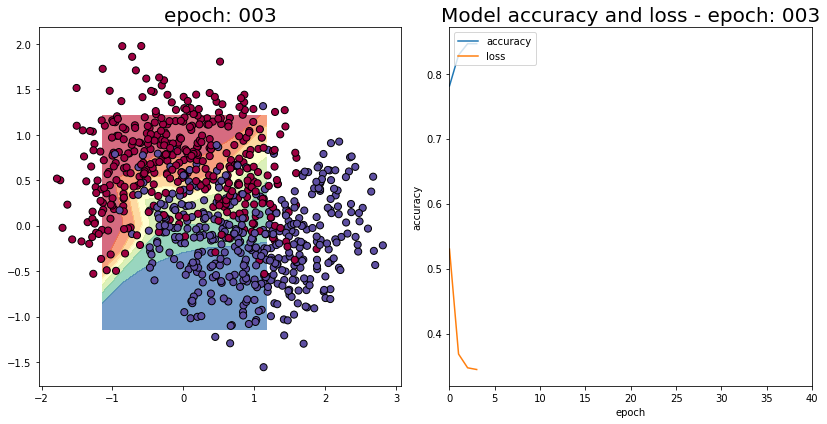

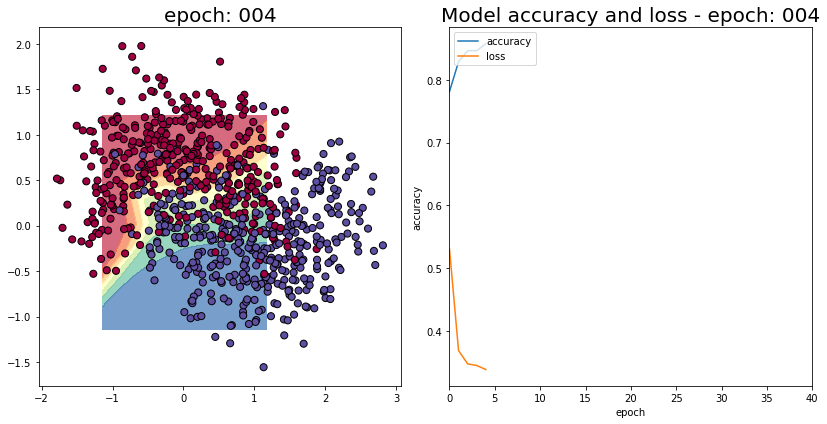

...

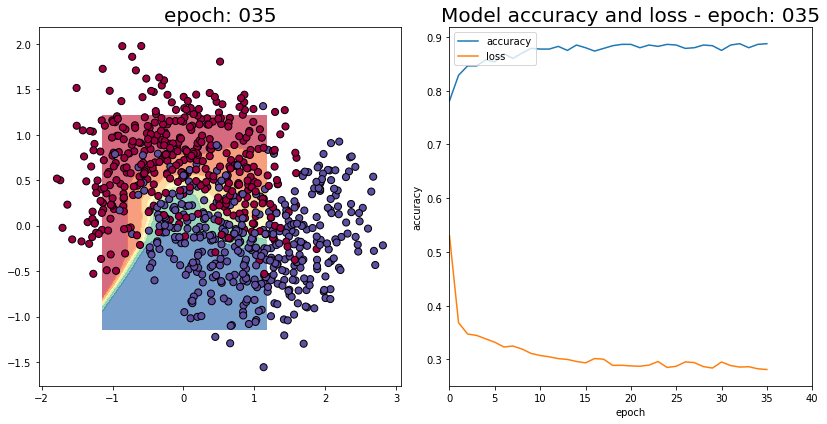

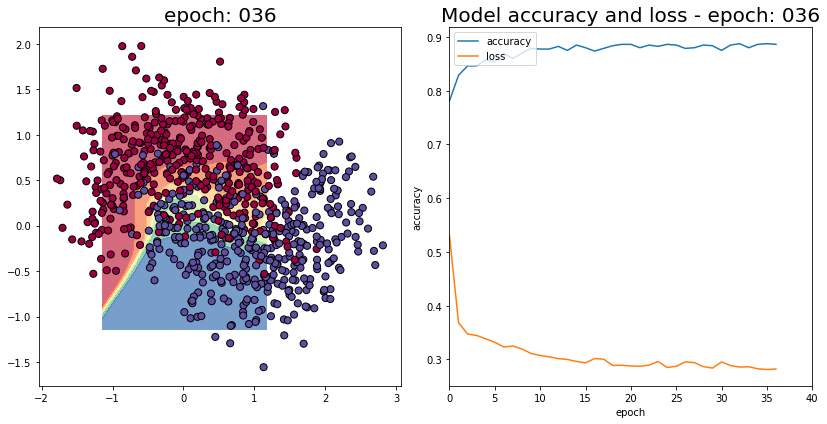

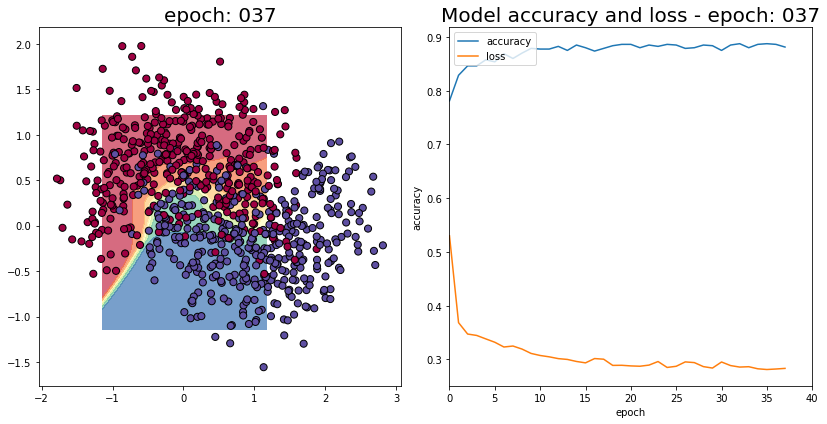

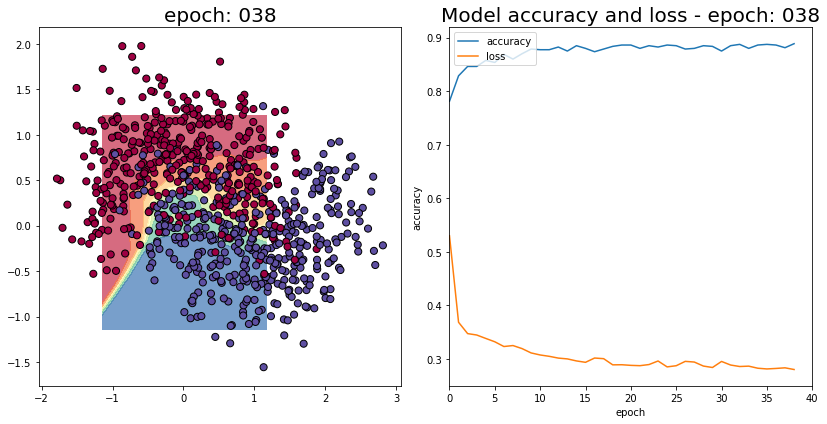

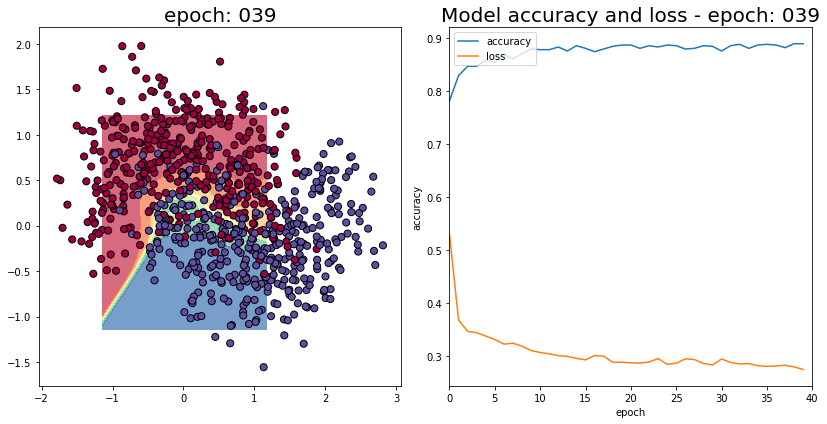

Test loss: 0.38653529509902
Test accuracy: 0.86


In [6]:
acc_history = []
loss_history = []
model = Sequential()
model.add(Dense(8, input_dim=2,activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
testmodelcb = keras.callbacks.LambdaCallback(on_epoch_end=save_model_prediction_graph)
model.compile(loss = 'binary_crossentropy', optimizer = 'adamax', metrics = ['accuracy'])
history = model.fit(X_train, y_train, epochs=N_EPOCHS, verbose=0, callbacks=[testmodelcb])
score = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

###Modelo usando regularización

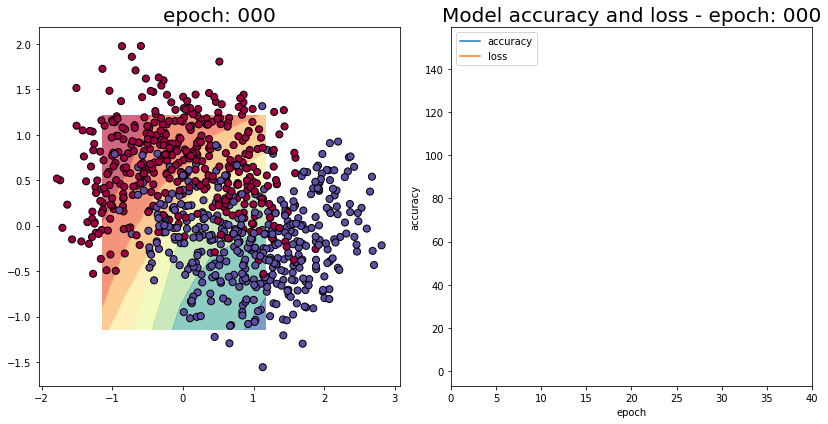

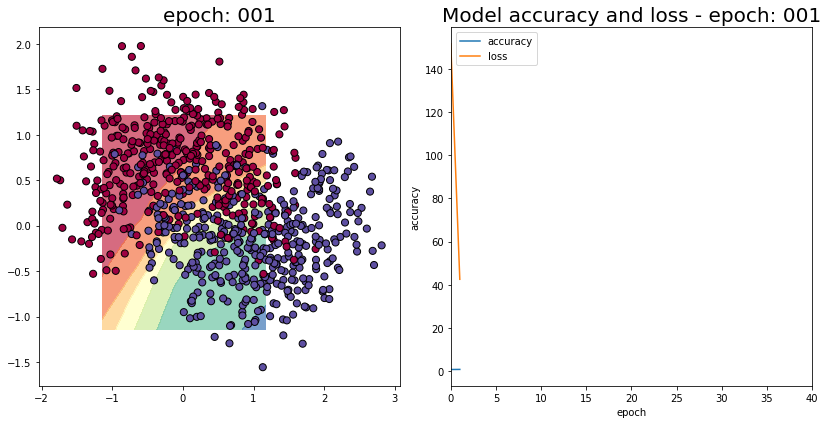

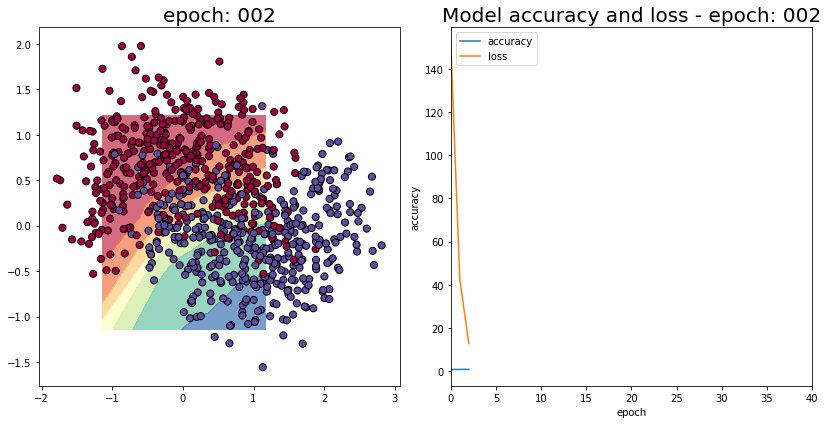

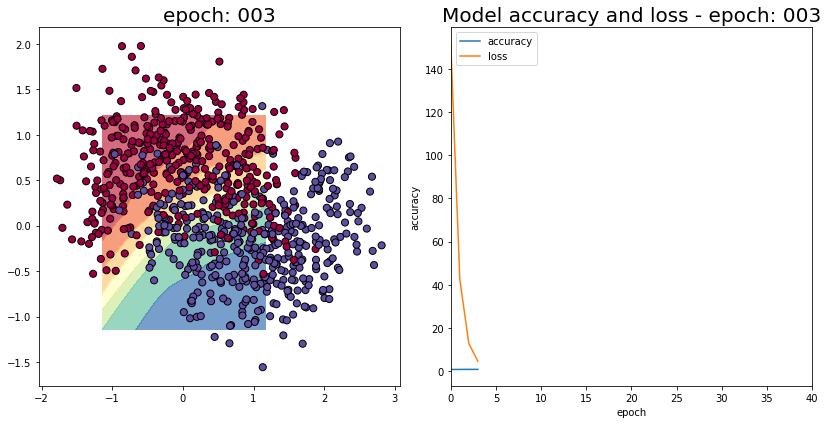

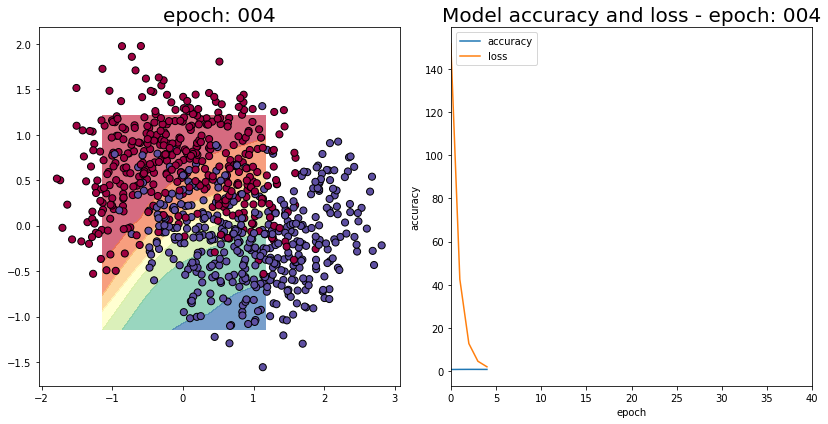

...

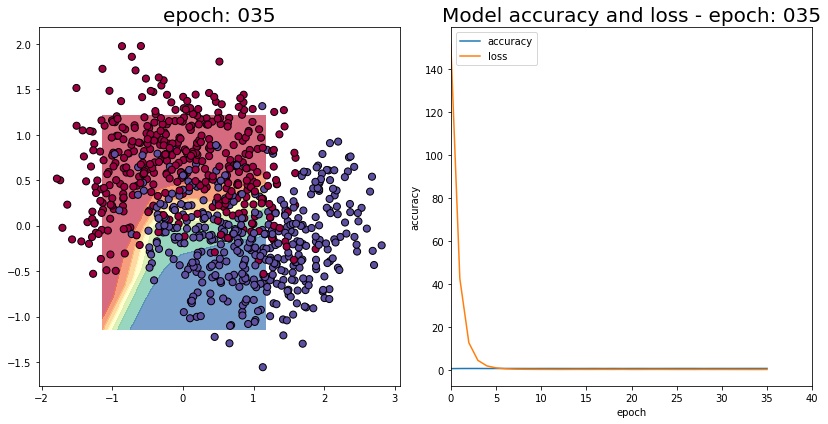

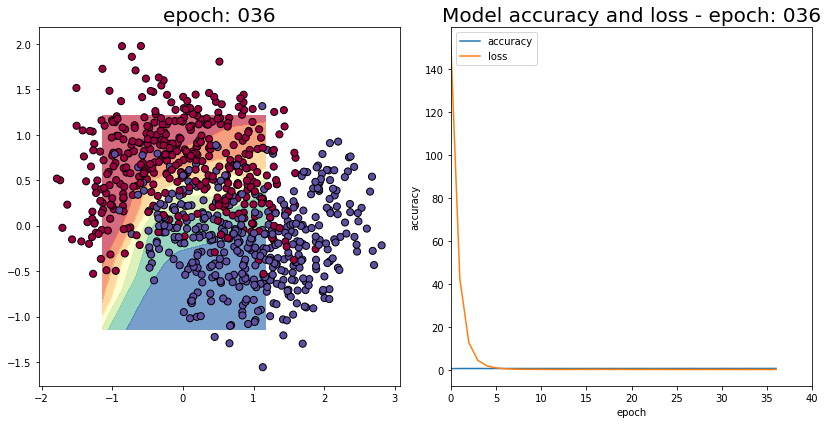

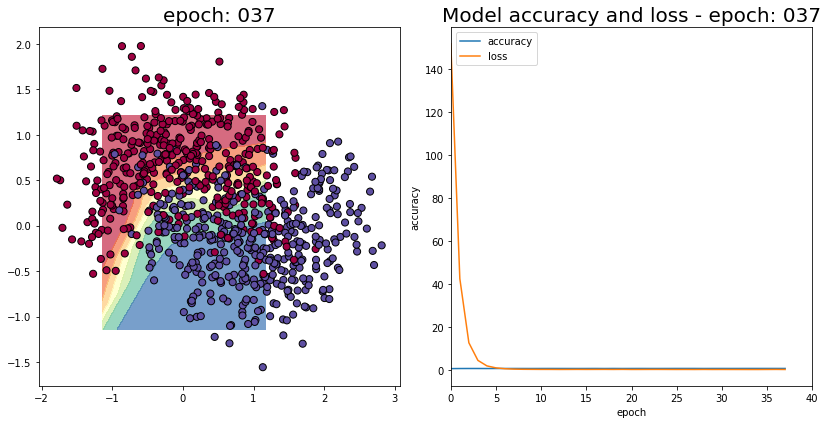

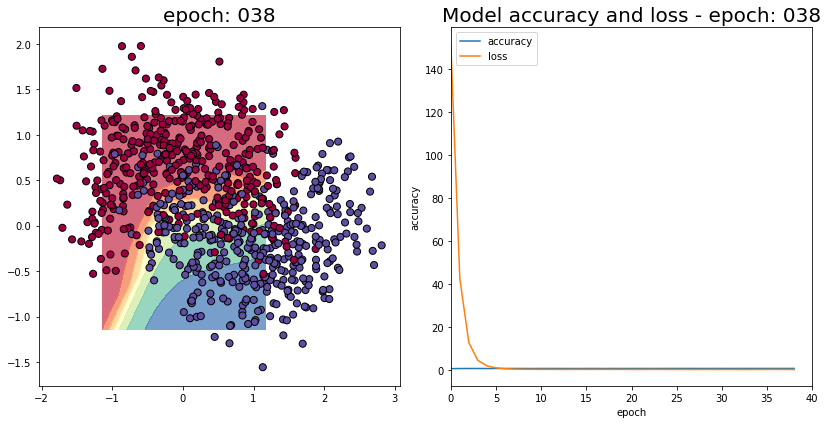

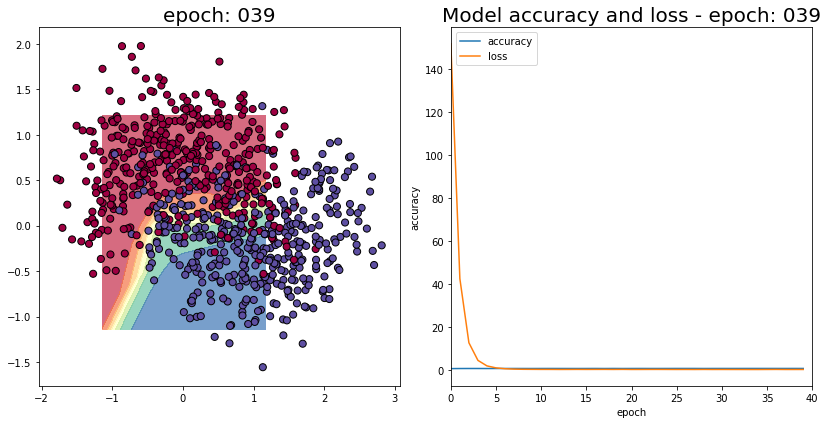

Test loss: 0.5124502348899841
Test accuracy: 0.81


In [7]:
from keras import regularizers
acc_history = []
loss_history = []
model = Sequential()
model.add(Dense(8, input_dim=2,activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.8)))
model.add(Dense(256, activation='relu'))
model.add(Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.8)))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
testmodelcb = keras.callbacks.LambdaCallback(on_epoch_end=save_model_prediction_graph)
model.compile(loss = 'binary_crossentropy', optimizer = 'adamax', metrics = ['accuracy'])
history = model.fit(X_train, y_train, epochs=N_EPOCHS, verbose=0, callbacks=[testmodelcb])
score = model.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

## **ANALISIS DE LOS RESULTADOS**

A pesar del hype que tienen la redes neurales, los resultados anteriores nos dan prueba de que se debe tener mucho cuidado en su uso ya que nos pueden generar modelos muy alejados de lo que buscamos. 

1. En el primer dataset la red neural usada nos permitió generar un modelo con una precisión muy alta. De hecho al comparar el avance del modelo se percibe claramente como el error(loss) disminuye vertiginosamente mientras la accuracy aumenta de igual manera hasta alcanzar un 98.5 % !!. Luego es un buen modelo para el dataset

### **overfitting vs underfitting**

Sin embargo en el segundo dataset el mismo esquema de red parece tener problemas. Dichos problemas caen dentro del tipo overfitting y underfitting

2. En el segundo modelo puede verse como a pesar de que el error tiende a disminuir y la accuracy a aumentar, hay un punto a partir del cual a medida que aumentan las epochs(epocas) no aumenta la accuracy y el error tiende incluso a aumenta ligeramente en ciertos momentos. Esto es muestra de que hay una situación de overftting para lo cual podria pensarse en modificar el modelo incluyendo *Resnets* las cuales son de gran ayuda en estas situaciones.

3. En el tercer modelo por el contrario vemos que el modelo dificilmente se adecua a los datos, por lo cual nos genera un underfitting, ya que aunque al final nos arroja una accuracy del 80% el error es bastante alto(0.51). Para esto habria que plantearse el implementar otro modelo que puede ser de machine learning más tradicional o realizar una modificación parcial o total de la red neuronal usada.



